## Funciones a utilizar

In [6]:
from Data_processing_support.data_loading_saving import load_feature_data
from Data_processing_support.dimension_reduction import reduce_dim,f_pairwise_distances
from Data_processing_support.metrics import metricas
from Data_processing_support.model_training import train_model
import pandas as pd
import numpy as np

# DATA TRAIN

## Cargando data de Train

In [28]:
data_train,df_final = load_feature_data('train_subset_features','train_subset_features_sound')

Loaded KEEaIcb92EI with shape: (18, 512)
Loaded keHoZJf3t2U with shape: (15, 512)
Loaded keK3qv5Nljc with shape: (15, 512)
Loaded KeMyLHQiTCI with shape: (18, 512)
Loaded kenEvdqCrL8 with shape: (18, 512)
Loaded KEnS0kYSsAY with shape: (18, 512)
Loaded KeOkjMaA4F8 with shape: (18, 512)
Loaded keR89NmDqUM with shape: (15, 512)
Loaded kETFtgRjueU with shape: (15, 512)
Loaded kEUk24tUH-c with shape: (6, 512)
Loaded kEUKP5OFbOk with shape: (18, 512)
Loaded Kf-sdMllGps with shape: (12, 512)
Loaded Kf5xVWGbJbQ with shape: (5, 512)
Loaded Kf8qJ4OBRuA with shape: (15, 512)
Loaded KfC9-6vnQks with shape: (17, 512)
Loaded kfd1wOdsh8k with shape: (18, 512)
Loaded KFDz2FXrL-4 with shape: (18, 512)
Loaded kfKK1tDOVKY with shape: (18, 512)
Loaded kFU7J-VIzAg with shape: (18, 512)
Loaded kg2U6Rv0tkY with shape: (13, 512)
Loaded KGbqEyo02ck with shape: (15, 512)
Loaded kgIk22yks0k with shape: (8, 512)
Loaded KgKnbf13xtU with shape: (15, 512)
Loaded KGkNULmOvOQ with shape: (14, 512)
Loaded KgmJrAGREEM 

In [29]:
print(data_train.shape)
print(df_final.shape)

(5345, 640)
(5345, 641)


## Reduccion de dimensionalidad - PCA && RandomProjection

PCA: 220 components explain 0.95 of the variance


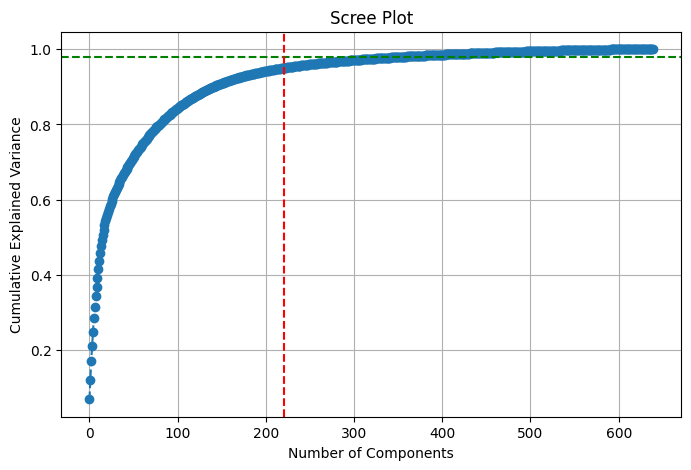

RP: 248 components selected


In [30]:
# reducir la dimension de la data
data_pca = reduce_dim(data_train, 'PCA')
data_rp = reduce_dim(data_train, 'RP')

In [33]:
print(data_train.shape)
print(data_pca.shape)
print(data_rp.shape)

(5345, 640)
(5345, 220)
(5345, 248)


### Pairwise distance

In [34]:
pca_avg_pairwise = f_pairwise_distances(data_pca)
rp_avg_pairwise = f_pairwise_distances(data_rp)
print(f'PCA average pairwise distance: {pca_avg_pairwise}')
print(f'RP average pairwise distance: {rp_avg_pairwise}')

PCA average pairwise distance: 17.124470909514574
RP average pairwise distance: 17.60007154788401


## ENTRENANDO EL DATA_TRAIN CON KMEANS

In [35]:
# entrenar el modelo
true_labels,pred_labels = train_model(data_train,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='train_subset.csv')
true_labels_pca,pred_labels_pca = train_model(data_pca,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='train_subset.csv')
true_labels_rp,pred_labels_rp = train_model(data_rp,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='train_subset.csv')

iteración 0
iteración 1
iteración 2
iteración 3
iteración 4
iteración 5
iteración 6
iteración 7
iteración 8
iteración 9
iteración 10
iteración 11
iteración 12
iteración 13
iteración 14
iteración 15
iteración 16
iteración 17
iteración 18
iteración 19
iteración 20
iteración 21
iteración 22
iteración 23
iteración 24
iteración 25
iteración 26
Convergió en la iteración 26
centroides_last [[0.57008675 0.52186615 0.66654091 ... 0.08284986 0.09063925 0.03076744]
 [0.62138082 1.22169132 0.76750585 ... 0.12831277 0.12736503 0.09252859]
 [0.35107978 0.83451348 0.41770129 ... 0.01913245 0.13883094 0.13747591]
 ...
 [0.72562142 0.56059402 0.45480183 ... 0.00837697 0.06802224 0.14674999]
 [0.87361959 0.70488894 0.44215853 ... 0.03341354 0.09332629 0.04008395]
 [0.75081212 0.63673166 0.50072862 ... 0.03359258 0.09676002 0.0449003 ]]
centroides_new [[0.57008675 0.52186615 0.66654091 ... 0.08284986 0.09063925 0.03076744]
 [0.62138082 1.22169132 0.76750585 ... 0.12831277 0.12736503 0.09252859]
 [0.35107

## METRICAS PARA LA DATA DE TRAINING

In [36]:
# metricas
metricas(data_train,true_labels,pred_labels)
metricas(data_pca,true_labels,pred_labels_pca,'PCA')
metricas(data_rp,true_labels,pred_labels_rp,'RP')

----------------------------------------
Silhouette Score - data : 0.1459421734420287
----------------------------------------
Adjusted Rand Index - data : 0.9203912230442917
----------------------------------------
Mutual Info Index - data : 0.9550894249173819
----------------------------------------


----------------------------------------
Silhouette Score - data PCA: 0.14233635426210092
----------------------------------------
Adjusted Rand Index - data PCA: 0.8085606893974381
----------------------------------------
Mutual Info Index - data PCA: 0.9146844305931976
----------------------------------------


----------------------------------------
Silhouette Score - data RP: 0.105209213424097
----------------------------------------
Adjusted Rand Index - data RP: 0.685003718236805
----------------------------------------
Mutual Info Index - data RP: 0.8638252963306645
----------------------------------------




# DATA DE VALIDATION

## Cargando features de Validation

In [7]:
#data_val,df_final = cargar_data('val_subset_features','val_subset_features_sound')

data_val,df_final = load_feature_data('val_subset_features','val_subset_features_sound')


Loaded --33Lscn6sk with shape: (11, 512)
Loaded -0dYbFhZsGU with shape: (15, 512)
Loaded -0WZKTu0xNk with shape: (18, 512)
Loaded -1DARulHLgw with shape: (18, 512)
Loaded -1QTRLQSzhQ with shape: (18, 512)
Loaded -2VKVjgNuE0 with shape: (11, 512)
Loaded -2VXhGGeOWg with shape: (18, 512)
Loaded -2zDnjMmI5U with shape: (10, 512)
Loaded -3cPJnxtl7U with shape: (15, 512)
Loaded -3oo45vpQV4 with shape: (15, 512)
Loaded -4JdZpx3zNk with shape: (18, 512)
Loaded -514AQUrSow with shape: (18, 512)
Loaded -5fnpyU2iE0 with shape: (15, 512)
Loaded -5fqwdtpSOY with shape: (9, 512)
Loaded -65aI53dvdE with shape: (18, 512)
Loaded -7E9WiX7QfA with shape: (18, 512)
Loaded -94nreFhQRg with shape: (12, 512)
Loaded -94oNUNdpQs with shape: (18, 512)
Loaded -9ILBd-ArtM with shape: (18, 512)
Loaded -B-GH43bTjk with shape: (18, 512)
Loaded -bH-BrGmJnM with shape: (18, 512)
Loaded -CaRbdIFhjI with shape: (18, 512)
Loaded -dvwA0Hzj6s with shape: (18, 512)
Loaded -he92lx6vH0 with shape: (9, 512)
Loaded -hjVL6WNC00

In [8]:
print(data_val.shape)
print(df_final.shape)

(855, 640)
(855, 641)


## Reduccion de dimensionalidad - PCA && RandomProjection

PCA: 189 components explain 0.95 of the variance


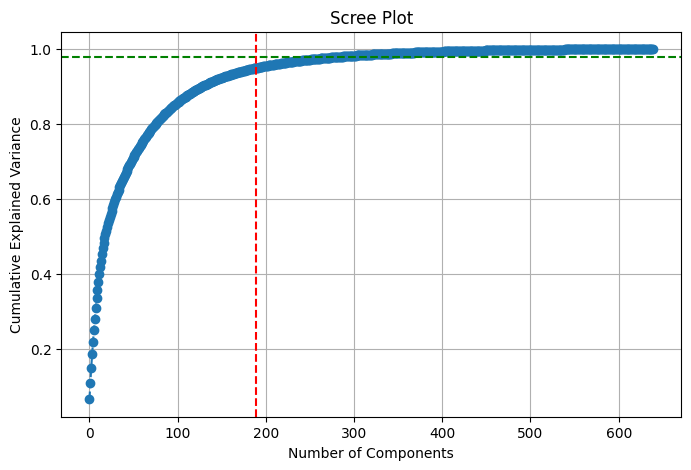

RP: 195 components selected


In [9]:
# reducir la dimension de la data
data_pca = reduce_dim(data_val, 'PCA')
data_rp = reduce_dim(data_val, 'RP')

In [10]:
print(data_val.shape)
print(data_pca.shape)
print(data_rp.shape)

(855, 640)
(855, 189)
(855, 195)


## ENTRENANDO LA DATA DE VALIDATION CON KMEANS

In [11]:
true_labels,pred_labels = train_model(data_val,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='val.csv')
true_labels_pca,pred_labels_pca = train_model(data_pca,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='val.csv')
true_labels_rp,pred_labels_rp = train_model(data_rp,df_final, 'KMeans',num_cluster=20,random_state=21,dir_truelabels='val.csv')

Convergió en la iteración 12
centroides_last [[0.66307387 1.41059849 1.07880922 ... 0.03714012 0.16262503 0.20148095]
 [0.72552817 1.19351404 1.06525698 ... 0.06346793 0.2324953  0.05335836]
 [1.30420592 0.61659763 0.64704296 ... 0.15008774 0.12012147 0.05605335]
 ...
 [0.50516912 2.42547141 1.89815894 ... 0.05705265 0.14398452 0.03973711]
 [0.64322571 0.55189047 0.51407822 ... 0.08538645 0.1018787  0.02643894]
 [0.88280844 0.60556471 0.44271936 ... 0.03093666 0.12538371 0.0748991 ]]
centroides_new [[0.66307387 1.41059849 1.07880922 ... 0.03714012 0.16262503 0.20148095]
 [0.72552817 1.19351404 1.06525698 ... 0.06346793 0.2324953  0.05335836]
 [1.30420592 0.61659763 0.64704296 ... 0.15008774 0.12012147 0.05605335]
 ...
 [0.50516912 2.42547141 1.89815894 ... 0.05705265 0.14398452 0.03973711]
 [0.64322571 0.55189047 0.51407822 ... 0.08538645 0.1018787  0.02643894]
 [0.88280844 0.60556471 0.44271936 ... 0.03093666 0.12538371 0.0748991 ]]
Convergió en la iteración 17
centroides_last [[ 4.81

## Metricas para Validation

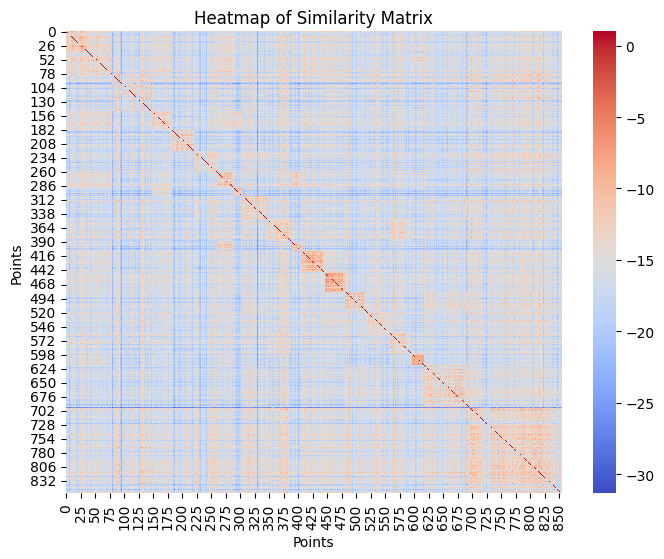

In [28]:
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de similitud
similarity_matrix = 1 - pairwise_distances(data_val, metric='euclidean')

# Obtener los índices ordenados por clusters
sorted_indices = np.argsort(pred_labels)

# Reordenar la matriz de similitud
sorted_similarity_matrix = similarity_matrix[sorted_indices, :]
sorted_similarity_matrix = sorted_similarity_matrix[:, sorted_indices]

# Generar la gráfica de la matriz de similitud
plt.figure(figsize=(8, 6))
sns.heatmap(sorted_similarity_matrix, cmap='coolwarm', cbar=True)
plt.title('Heatmap of Similarity Matrix')
plt.xlabel('Points')
plt.ylabel('Points')
plt.show()

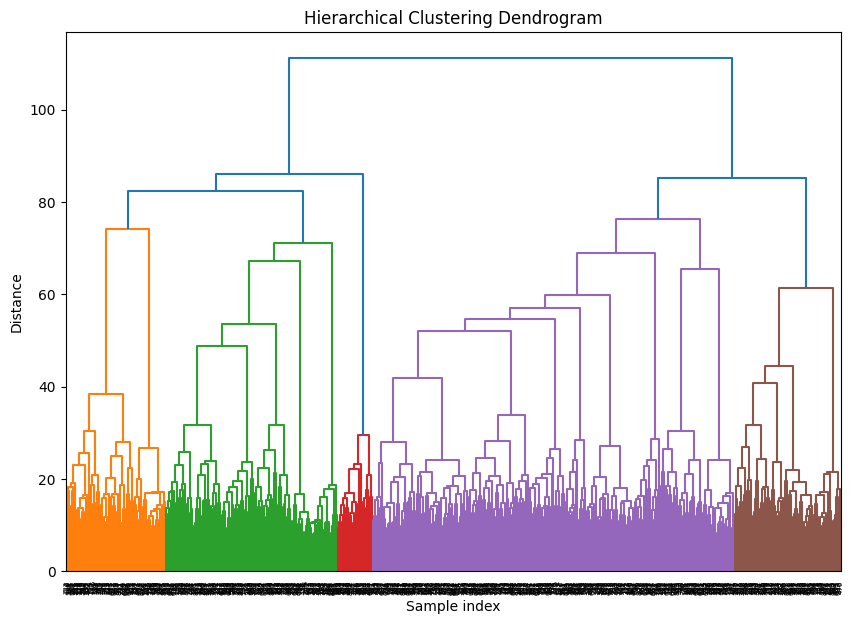

In [22]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Tus datos

# Calcular el linkage para el dendrograma
linked = linkage(data_val, method='ward')

# Dendrograma
plt.figure(figsize=(10, 7))
dendrogram(linked,
            orientation='top',
            distance_sort='descending',
            show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()

In [42]:
# metricas
metricas(data_val,true_labels,pred_labels)
metricas(data_pca,true_labels,pred_labels_pca,'PCA')
metricas(data_rp,true_labels,pred_labels_rp,'RP')

----------------------------------------
Silhouette Score - data : 0.09819458742834114
----------------------------------------
Adjusted Rand Index - data : 0.4863562821607343
----------------------------------------
Mutual Info Index - data : 0.719140222542964
----------------------------------------


----------------------------------------
Silhouette Score - data PCA: 0.08629789363571835
----------------------------------------
Adjusted Rand Index - data PCA: 0.4901195712168832
----------------------------------------
Mutual Info Index - data PCA: 0.7156051092209708
----------------------------------------


----------------------------------------
Silhouette Score - data RP: 0.08903766462578619
----------------------------------------
Adjusted Rand Index - data RP: 0.5414304676286935
----------------------------------------
Mutual Info Index - data RP: 0.7163974817557333
----------------------------------------




# DATA TEST

## Cargando features de Test

In [30]:
data_test,df_final = load_feature_data('test_subset_features','test_subset_features_sound',type_merge='left')

Loaded -3T2VPGo2jI with shape: (15, 512)
Loaded -7Wz9S-ZZz4 with shape: (15, 512)
Loaded -a1f1ikmdd8 with shape: (18, 512)
Loaded -AZMzKjls-k with shape: (15, 512)
Loaded -bGVnGCy2yY with shape: (18, 512)
Loaded -BrNqmFy-6Y with shape: (9, 512)
Loaded -CsBjy8T-II with shape: (18, 512)
Loaded -eOxQpTp5zM with shape: (18, 512)
Loaded -FhZ1JPZYl0 with shape: (11, 512)
Loaded -fyfEc1C5Hc with shape: (18, 512)
Loaded -IdatujDsqA with shape: (18, 512)
Loaded -J8jfO0Fp6M with shape: (18, 512)
Loaded -JdfkIKg0w4 with shape: (18, 512)
Loaded -Npm2udxeAE with shape: (18, 512)
Loaded -pBHLSZrn3k with shape: (11, 512)
Loaded -RCv-107T5w with shape: (15, 512)
Loaded -rhOaNjvwWo with shape: (9, 512)
Loaded -rhOXmTJT1M with shape: (18, 512)
Loaded -sODNa60qVI with shape: (18, 512)
Loaded -W2Pcut-jEU with shape: (18, 512)
Loaded -WAMHNq45kY with shape: (18, 512)
Loaded -WKQMew6YXw with shape: (18, 512)
Loaded -XI64LgAgxM with shape: (18, 512)
Loaded -XzpQxfVypI with shape: (18, 512)
Loaded -Yn59LWpYdQ

In [31]:
print(data_test.shape)
print(df_final.shape)

(1626, 640)
(1626, 641)


## Reduccion de dimensionalidad - PCA && RandomProjection

PCA: 210 components explain 0.95 of the variance


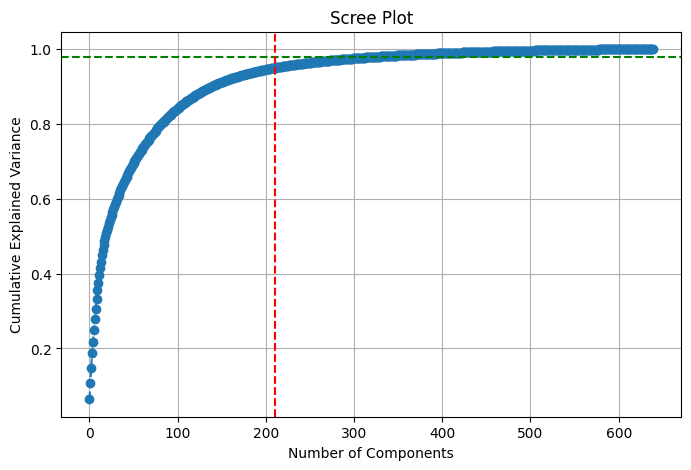

RP: 214 components selected


In [32]:
data_pca = reduce_dim(data_test, 'PCA')
data_rp = reduce_dim(data_test, 'RP')

In [33]:
print(data_test.shape)
print(data_pca.shape)
print(data_rp.shape)

(1626, 640)
(1626, 210)
(1626, 214)


## EXPERIMENTACION CON 1000 TRAIN

In [35]:
from modelos.Kmeans import KMeans, encontrar_mejor_semilla

# encontrar la mejor semilla
mejor_kmean = encontrar_mejor_semilla(data_test,num_cluster=20,init=1,num_inicializaciones=20)

Semilla: 1


Convergió en la iteración 47
centroides_last [[0.64397394 0.66938506 0.47336123 ... 0.01400409 0.08440875 0.06690653]
 [0.87917287 0.47669131 0.78590702 ... 0.09350571 0.17007228 0.07267041]
 [0.8432277  0.64549763 0.70689248 ... 0.01140132 0.11877815 0.01889006]
 ...
 [0.52026966 0.73490614 0.41275718 ... 0.03784957 0.15148478 0.06145367]
 [0.87613461 0.44238546 0.48379594 ... 0.02984175 0.20219684 0.08125718]
 [0.77562797 0.69020652 0.72743536 ... 0.0559051  0.16833602 0.04189636]]
centroides_new [[0.64397394 0.66938506 0.47336123 ... 0.01400409 0.08440875 0.06690653]
 [0.87917287 0.47669131 0.78590702 ... 0.09350571 0.17007228 0.07267041]
 [0.8432277  0.64549763 0.70689248 ... 0.01140132 0.11877815 0.01889006]
 ...
 [0.52026966 0.73490614 0.41275718 ... 0.03784957 0.15148478 0.06145367]
 [0.87613461 0.44238546 0.48379594 ... 0.02984175 0.20219684 0.08125718]
 [0.77562797 0.69020652 0.72743536 ... 0.0559051  0.16833602 0.04189636]]
Semilla: 2
Convergió en la iteración 30
centroides_l

## ENTRENANDO LA DATA DE TEST CON KMEANS

In [36]:
true_labels,pred_labels = train_model(data_test,df_final, 'KMeans',num_cluster=20,random_state=13)
true_labels_pca,pred_labels_pca = train_model(data_pca,df_final, 'KMeans',num_cluster=20,random_state=13)
true_labels_rp,pred_labels_rp = train_model(data_rp,df_final, 'KMeans',num_cluster=20,random_state=13)

Convergió en la iteración 39
centroides_last [[0.52350295 0.64370827 0.43165682 ... 0.05794703 0.2196378  0.0776237 ]
 [0.41279556 0.89204092 0.40048556 ... 0.01724396 0.14580806 0.15916171]
 [0.87224322 0.48318526 0.78050055 ... 0.09211011 0.17159041 0.07269654]
 ...
 [0.85742309 0.61119823 0.57630928 ... 0.00329749 0.06360755 0.12849687]
 [0.62270035 0.60748151 0.69612949 ... 0.07495487 0.10353276 0.020686  ]
 [0.93313763 0.65769404 0.59491408 ... 0.02229242 0.11696424 0.04881106]]
centroides_new [[0.52350295 0.64370827 0.43165682 ... 0.05794703 0.2196378  0.0776237 ]
 [0.41279556 0.89204092 0.40048556 ... 0.01724396 0.14580806 0.15916171]
 [0.87224322 0.48318526 0.78050055 ... 0.09211011 0.17159041 0.07269654]
 ...
 [0.85742309 0.61119823 0.57630928 ... 0.00329749 0.06360755 0.12849687]
 [0.62270035 0.60748151 0.69612949 ... 0.07495487 0.10353276 0.020686  ]
 [0.93313763 0.65769404 0.59491408 ... 0.02229242 0.11696424 0.04881106]]
Convergió en la iteración 34
centroides_last [[ 3.06

In [37]:
print('----------------------------------------')
df_final['predic_label'] = pred_labels
df_final['predic_label_pca'] = pred_labels_pca
df_final['predic_label_rp'] = pred_labels_rp


----------------------------------------


### Extrayendo los videos de test que pide el kaggle

In [38]:
import pandas as pd
# cargamos el test_subset_10.csv
df_test = pd.read_csv('test_subset_10.csv')

# los df_test youtube_id los pasamos a una lista
youtube_id = df_test['youtube_id'].tolist()
#print(youtube_id)

# extraemos de df los videos que estan en youtube_id
df_result = df_final[df_final['video'].isin(youtube_id)]

print(df_result[['video','predic_label','predic_label_pca','predic_label_rp']].head(5))

         video  predic_label  predic_label_pca  predic_label_rp
1  -7Wz9S-ZZz4             0                 0                8
2  -a1f1ikmdd8            12                17               12
4  -bGVnGCy2yY             1                 1                1
5  -BrNqmFy-6Y            11                11                6
6  -CsBjy8T-II             1                 1                1


## Metricas de test

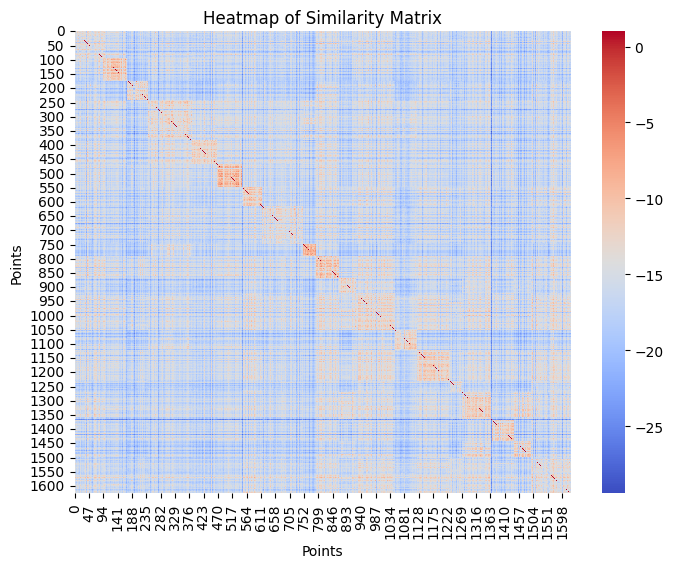

In [39]:
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de similitud
similarity_matrix = 1 - pairwise_distances(data_test, metric='euclidean')

# Obtener los índices ordenados por clusters
sorted_indices = np.argsort(pred_labels)

# Reordenar la matriz de similitud
sorted_similarity_matrix = similarity_matrix[sorted_indices, :]
sorted_similarity_matrix = sorted_similarity_matrix[:, sorted_indices]

# Generar la gráfica de la matriz de similitud
plt.figure(figsize=(8, 6))
sns.heatmap(sorted_similarity_matrix, cmap='coolwarm', cbar=True)
plt.title('Heatmap of Similarity Matrix')
plt.xlabel('Points')
plt.ylabel('Points')
plt.show()

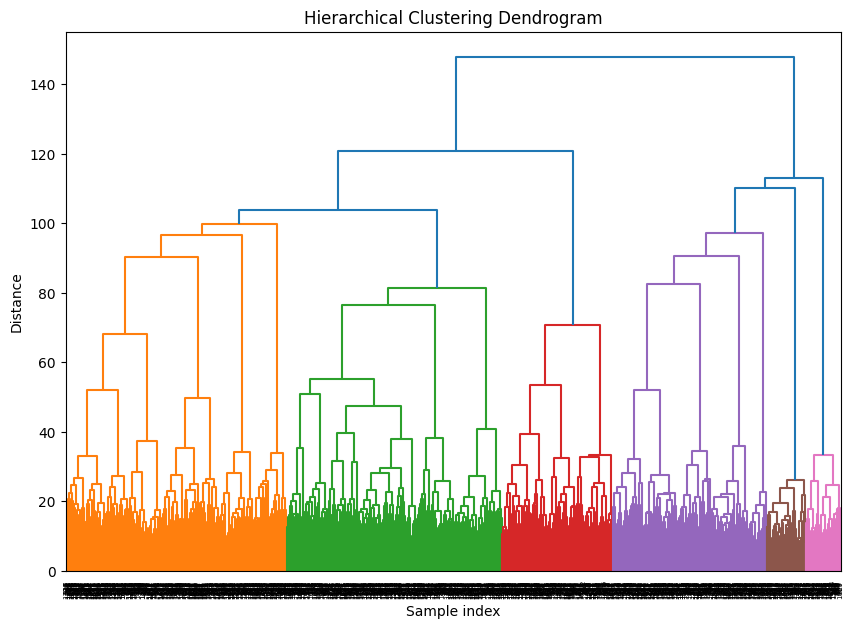

In [40]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Tus datos

# Calcular el linkage para el dendrograma
linked = linkage(data_test, method='ward')

# Dendrograma
plt.figure(figsize=(10, 7))
dendrogram(linked,
            orientation='top',
            distance_sort='descending',
            show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()

In [71]:
from sklearn.metrics import silhouette_score, davies_bouldin_score
s_core = silhouette_score(data_test,pred_labels)

print('----------------------------------------')
print(f"Silhouette Score: {s_core}")
print('----------------------------------------')
print('\n')
s_core = silhouette_score(data_pca,pred_labels_pca)

print('----------------------------------------')
print(f"Silhouette Score PCA: {s_core}")
print('----------------------------------------')
print('\n')
s_core = silhouette_score(data_rp,pred_labels_rp)

print('----------------------------------------')
print(f"Silhouette Score RP: {s_core}")
print('----------------------------------------')


----------------------------------------
Silhouette Score: 0.09449805107730493
----------------------------------------


----------------------------------------
Silhouette Score PCA: 0.10186503987461334
----------------------------------------


----------------------------------------
Silhouette Score RP: 0.08875180910875075
----------------------------------------


## Guardando la data de test

In [72]:
labels = np.array(df_result['predic_label_rp'])
youtube_id = np.array(df_result['video'])
print(youtube_id.shape)
print(labels.shape)

# crear una lista de tuplas con los youtube_id y los labels
y_pred = []
for i in range(len(youtube_id)):
    y_pred.append((youtube_id[i], labels[i]))

# 
df_y_pred = pd.DataFrame(y_pred, columns=['youtube_id', 'result'])
# no tener el indice
df_y_pred.set_index('youtube_id', inplace=True)
df_y_pred.to_csv("y_predichos/normal/y_pred_seed_55_sound_&&_video_rp.csv")

(805,)
(805,)


# Agglomerating method

# Preparando data para procesar validation

In [25]:
from Data_processing_support.data_loading_saving import load_feature_data
from Data_processing_support.feature_summary_techniques import summary_by_mean
import pandas as pd

data_val,df_final = load_feature_data('val_subset_features','val_subset_features_sound')
print(df_final['video'].head(10))


Loaded --33Lscn6sk with shape: (11, 512)
Loaded -0dYbFhZsGU with shape: (15, 512)
Loaded -0WZKTu0xNk with shape: (18, 512)
Loaded -1DARulHLgw with shape: (18, 512)
Loaded -1QTRLQSzhQ with shape: (18, 512)
Loaded -2VKVjgNuE0 with shape: (11, 512)
Loaded -2VXhGGeOWg with shape: (18, 512)
Loaded -2zDnjMmI5U with shape: (10, 512)
Loaded -3cPJnxtl7U with shape: (15, 512)
Loaded -3oo45vpQV4 with shape: (15, 512)
Loaded -4JdZpx3zNk with shape: (18, 512)
Loaded -514AQUrSow with shape: (18, 512)
Loaded -5fnpyU2iE0 with shape: (15, 512)
Loaded -5fqwdtpSOY with shape: (9, 512)
Loaded -65aI53dvdE with shape: (18, 512)
Loaded -7E9WiX7QfA with shape: (18, 512)
Loaded -94nreFhQRg with shape: (12, 512)
Loaded -94oNUNdpQs with shape: (18, 512)
Loaded -9ILBd-ArtM with shape: (18, 512)
Loaded -B-GH43bTjk with shape: (18, 512)
Loaded -bH-BrGmJnM with shape: (18, 512)
Loaded -CaRbdIFhjI with shape: (18, 512)
Loaded -dvwA0Hzj6s with shape: (18, 512)
Loaded -he92lx6vH0 with shape: (9, 512)
Loaded -hjVL6WNC00

In [26]:
print(data_val.shape)
print(df_final.shape)


(855, 640)
(855, 641)


## Reduccion de dimensionalidad - PCA && RandomProjection

PCA: 189 components explain 0.95 of the variance


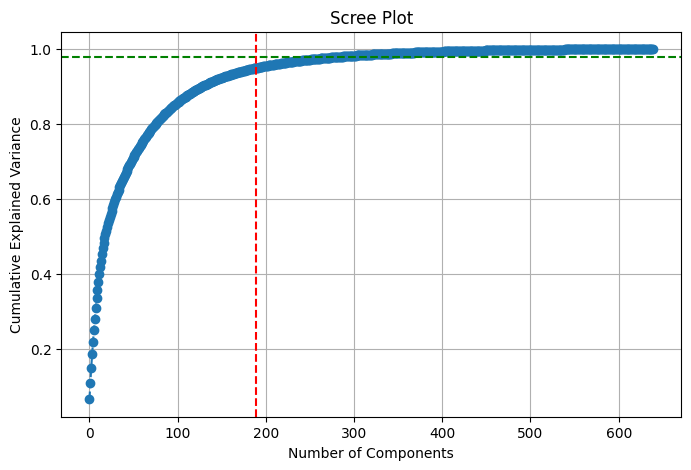

RP: 195 components selected


In [27]:
data_pca = reduce_dim(data_val, 'PCA')
data_rp = reduce_dim(data_val, 'RP')

In [30]:
print(data_val.shape)
print(data_pca.shape)
print(data_rp.shape)

(855, 640)
(855, 189)
(855, 195)


In [31]:
true_labels,pred_labels = train_model(data_val,df_final, 'Agglomerative',num_cluster=20,random_state=21,dir_truelabels='val.csv')
true_labels_pca,pred_labels_pca = train_model(data_pca,df_final, 'Agglomerative',num_cluster=20,random_state=21,dir_truelabels='val.csv')
true_labels_rp,pred_labels_rp = train_model(data_rp,df_final, 'Agglomerative',num_cluster=20,random_state=21,dir_truelabels='val.csv')

855
854
853
852
851
850
849
848
847
847
846
845
844
844
843
842
841
840
839
838
837
836
835
834
833
832
832
832
831
830
829
828
827
826
825
824
823
822
821
820
819
818
818
817
816
816
815
814
813
812
811
810
809
808
807
806
806
805
804
803
802
801
800
799
798
797
796
795
794
793
792
791
790
789
788
787
786
785
785
784
783
782
782
782
782
782
782
782
781
780
779
778
777
776
776
776
775
774
773
772
771
770
769
768
767
766
765
764
763
762
761
761
761
761
761
761
761
760
759
758
757
756
755
754
753
752
751
751
750
749
748
747
746
745
744
743
742
741
740
739
738
737
736
735
734
733
732
731
730
729
728
727
727
727
727
727
727
727
727
727
727
727
727
727
727
726
725
724
723
722
721
720
719
718
717
716
715
714
713
712
711
710
709
708
707
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
706
705
704
703
702
701
700
699
699
699
699
699
699
699
699
699
699
698
697
696
695
694
693
692
691
690
689
689
689
689
689
689
689
689
689
688
687
686
685
684
683
682
681
680
679
678


## METRICAS PARA LA DATA DE VALIDATION

In [33]:
metricas(data_val,true_labels,pred_labels)
metricas(data_pca,true_labels,pred_labels_pca,'PCA')
metricas(data_rp,true_labels,pred_labels_rp,'RP')

----------------------------------------
Silhouette Score - data : 0.04454087367953484
----------------------------------------
Adjusted Rand Index - data : 5.716678395231085e-05
----------------------------------------
Mutual Info Index - data : 0.002163209883237923
----------------------------------------


----------------------------------------
Silhouette Score - data PCA: 0.02722265477714051
----------------------------------------
Adjusted Rand Index - data PCA: 3.401544150777595e-05
----------------------------------------
Mutual Info Index - data PCA: 0.0010982041020816016
----------------------------------------


----------------------------------------
Silhouette Score - data RP: 0.03620686781566866
----------------------------------------
Adjusted Rand Index - data RP: -1.4183094270117269e-05
----------------------------------------
Mutual Info Index - data RP: 0.0009559314581409952
----------------------------------------




# DATA TEST

## Cargando features de Test

In [61]:
data_test,df_final = load_feature_data('test_subset_features','test_subset_features_sound',type_merge='left')

Loaded -3T2VPGo2jI with shape: (15, 512)
Loaded -7Wz9S-ZZz4 with shape: (15, 512)
Loaded -a1f1ikmdd8 with shape: (18, 512)
Loaded -AZMzKjls-k with shape: (15, 512)
Loaded -bGVnGCy2yY with shape: (18, 512)
Loaded -BrNqmFy-6Y with shape: (9, 512)
Loaded -CsBjy8T-II with shape: (18, 512)
Loaded -eOxQpTp5zM with shape: (18, 512)
Loaded -FhZ1JPZYl0 with shape: (11, 512)
Loaded -fyfEc1C5Hc with shape: (18, 512)
Loaded -IdatujDsqA with shape: (18, 512)
Loaded -J8jfO0Fp6M with shape: (18, 512)
Loaded -JdfkIKg0w4 with shape: (18, 512)
Loaded -Npm2udxeAE with shape: (18, 512)
Loaded -pBHLSZrn3k with shape: (11, 512)
Loaded -RCv-107T5w with shape: (15, 512)
Loaded -rhOaNjvwWo with shape: (9, 512)
Loaded -rhOXmTJT1M with shape: (18, 512)
Loaded -sODNa60qVI with shape: (18, 512)
Loaded -W2Pcut-jEU with shape: (18, 512)
Loaded -WAMHNq45kY with shape: (18, 512)
Loaded -WKQMew6YXw with shape: (18, 512)
Loaded -XI64LgAgxM with shape: (18, 512)
Loaded -XzpQxfVypI with shape: (18, 512)
Loaded -Yn59LWpYdQ

In [62]:
print(data_test.shape)
print(df_final.shape)

(1626, 640)
(1626, 641)


## Reduccion de dimensionalidad - PCA && RandomProjection

PCA: 210 components explain 0.95 of the variance


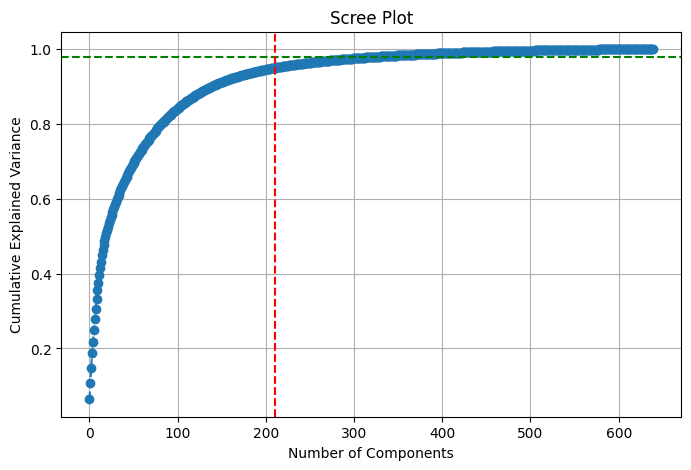

RP: 214 components selected


In [37]:
data_pca = reduce_dim(data_test, 'PCA')
data_rp = reduce_dim(data_test, 'RP')

In [38]:
print(data_test.shape)
print(data_pca.shape)
print(data_rp.shape)

(1626, 640)
(1626, 210)
(1626, 214)


## ENTRENANDO LA DATA DE TEST CON Agglomerative

In [39]:
true_labels,pred_labels = train_model(data_test,df_final, 'Agglomerative',num_cluster=20)
true_labels_pca,pred_labels_pca = train_model(data_pca,df_final, 'Agglomerative',num_cluster=20)
true_labels_rp,pred_labels_rp = train_model(data_rp,df_final, 'Agglomerative',num_cluster=20)

1626
1625
1624
1623
1622
1621
1621
1620
1619
1618
1617
1616
1615
1614
1613
1612
1612
1611
1611
1611
1611
1611
1610
1610
1610
1610
1609
1609
1609
1609
1609
1608
1607
1606
1605
1604
1603
1603
1602
1601
1601
1601
1601
1601
1601
1601
1601
1601
1601
1600
1599
1598
1597
1596
1595
1594
1593
1592
1591
1591
1591
1591
1591
1590
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1589
1588
1588
1588
1587
1587
1586
1586
1586
1586
1586
1586
1586
1586
1586
1586
1585
1584
1584
1584
1584
1584
1583
1582
1581
1580
1579
1578
1577
1576
1575
1575
1575
1575
1575
1575
1575
1575
1575
1575
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1574
1573
1572
1571
1570
1569
1568
1567
1566
1565
1565
1565
1564
1564
1564
1563
1563
1563
1563
1563
1562
1561
1560
1559
1558
1557
1556
1555
1555
1555
1555
1555
1555
1555
1555
1555
1555
1554
1554
1554


In [41]:
print('----------------------------------------')
df_final['predic_label'] = pred_labels
df_final['predic_label_pca'] = pred_labels_pca
df_final['predic_label_rp'] = pred_labels_rp

----------------------------------------


### Extrayendo los videos de test que pide el kaggle

In [42]:
# cargamos el test_subset_10.csv
df_test = pd.read_csv('test_subset_10.csv')

# los df_test youtube_id los pasamos a una lista
youtube_id = df_test['youtube_id'].tolist()
#print(youtube_id)

# extraemos de df los videos que estan en youtube_id
df_final = df_final[df_final['video'].isin(youtube_id)]

print(df_final[['video','predic_label','predic_label_pca','predic_label_rp']])

            video  predic_label  predic_label_pca  predic_label_rp
1     -7Wz9S-ZZz4             0                 0                0
2     -a1f1ikmdd8             0                 0                0
4     -bGVnGCy2yY             0                 0                0
5     -BrNqmFy-6Y             0                 0                0
6     -CsBjy8T-II             0                 0                0
...           ...           ...               ...              ...
1620  ZTTEkAxEnUs             0                 0                0
1622  zujZagp-4jQ             0                 0                0
1623  ZuvChCAjbak             0                 0                0
1624  ZxpwgIZg4lI             0                 0                0
1625  zz1YMml9Z6k             0                 0                0

[805 rows x 4 columns]


## Metrica de silhouette_score para el test

In [43]:
from sklearn.metrics import silhouette_score, davies_bouldin_score
s_core = silhouette_score(data_test,pred_labels)

print('----------------------------------------')
print(f"Silhouette Score: {s_core}")
print('----------------------------------------')
print('\n')
s_core = silhouette_score(data_pca,pred_labels_pca)

print('----------------------------------------')
print(f"Silhouette Score PCA: {s_core}")
print('----------------------------------------')
print('\n')
s_core = silhouette_score(data_rp,pred_labels_rp)

print('----------------------------------------')
print(f"Silhouette Score RP: {s_core}")
print('----------------------------------------')


----------------------------------------
Silhouette Score: 0.059391394189259226
----------------------------------------


----------------------------------------
Silhouette Score PCA: 0.06501532405769375
----------------------------------------


----------------------------------------
Silhouette Score RP: 0.06011127121721371
----------------------------------------


## Guardando la data de test

In [46]:
labels = np.array(df_final['predic_label_rp'])
youtube_id = np.array(df_final['video'])
print(youtube_id.shape)
print(labels.shape)

# crear una lista de tuplas con los youtube_id y los labels
y_pred = []
for i in range(len(youtube_id)):
    y_pred.append((youtube_id[i], labels[i]))

# 
df_y_pred = pd.DataFrame(y_pred, columns=['youtube_id', 'result'])
# no tener el indice
df_y_pred.set_index('youtube_id', inplace=True)
df_y_pred.to_csv("y_pred_rp.csv")

(805,)
(805,)
